# Experimentation with libraries and other things.

(3888, 2592)
(295, 171)


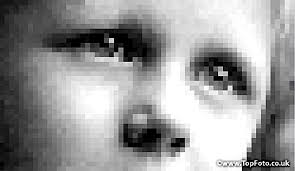

In [1]:
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
img=Image.open("images.jpg")
img2=Image.open("cat.jpeg")
image = mpimg.imread('cat.jpeg')
print(img2.size)	
print(img.size)
img

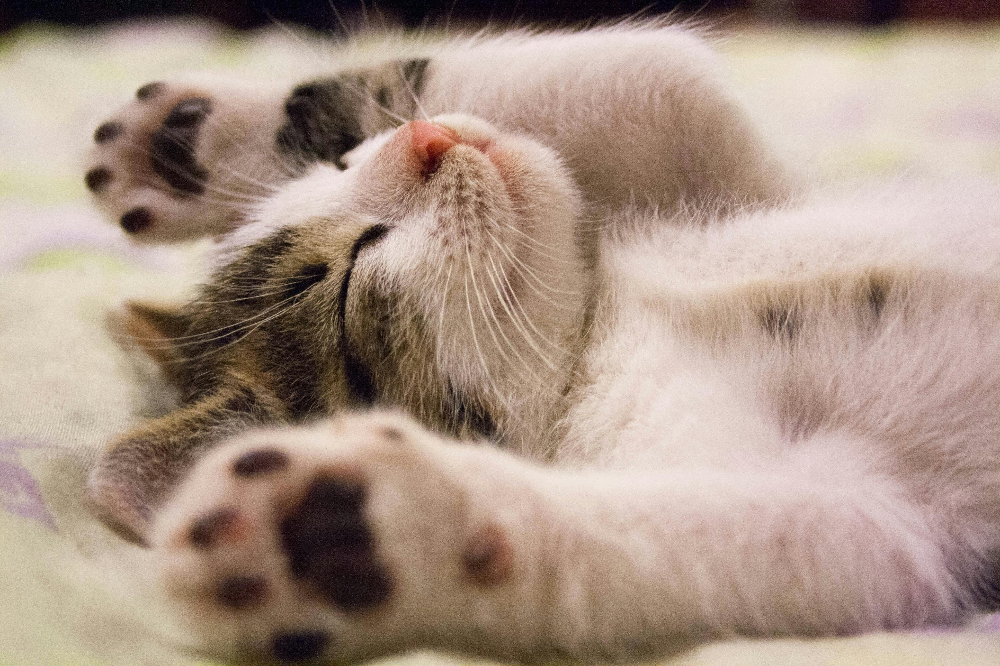

In [2]:
img2

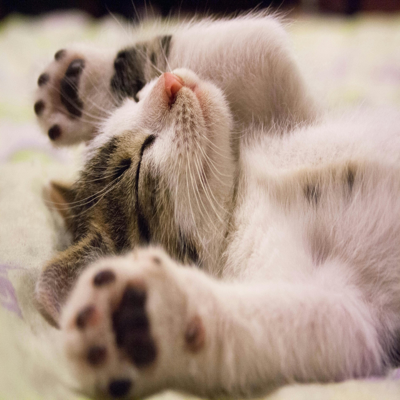

In [3]:
img2=img2.resize((400,400), resample=Image.BICUBIC)
img2

In [4]:
img2.getpixel((0,0)) # colors in the first pixel. (R,G,B)
r,g,b=img2.split()

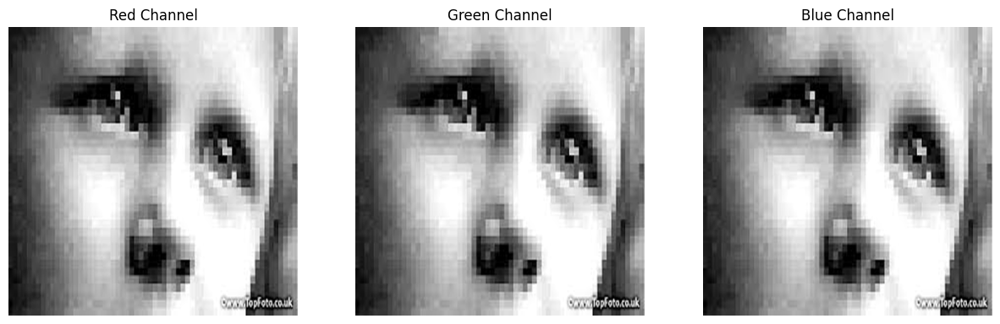

In [5]:
img_new=img.resize((400,400), resample=Image.BICUBIC)
# Split the grayscale image into its channels
r, g, b = img_new.split()

# Plot the channels
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

axs[0].imshow(r, cmap='gray')
axs[0].set_title("Red Channel")
axs[0].axis('off')

axs[1].imshow(g, cmap='gray')
axs[1].set_title("Green Channel")
axs[1].axis('off')

axs[2].imshow(b, cmap='gray')
axs[2].set_title("Blue Channel")
axs[2].axis('off')

plt.show()

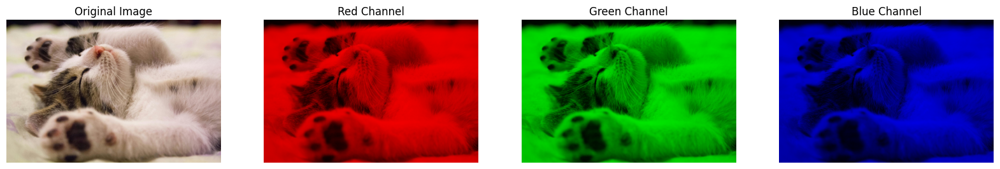

In [6]:
r = image.copy()
r[:, :, 1] = 0  # Zero out the green channel
r[:, :, 2] = 0  # Zero out the blue channel

g = image.copy()
g[:, :, 0] = 0  # Zero out the red channel
g[:, :, 2] = 0  # Zero out the blue channel

b = image.copy()
b[:, :, 0] = 0  # Zero out the red channel
b[:, :, 1] = 0  # Zero out the green channel

# Plot the images
fig, axs = plt.subplots(1, 4, figsize=(20,20))

axs[0].imshow(image)
axs[0].set_title("Original Image")
axs[0].axis('off')


axs[1].imshow(r)
axs[1].set_title("Red Channel")
axs[1].axis('off')

axs[2].imshow(g)
axs[2].set_title("Green Channel")
axs[2].axis('off')

axs[3].imshow(b)
axs[3].set_title("Blue Channel")
axs[3].axis('off')

plt.show()

# Implimenting the paper, using y for training.

In [7]:
import torch
import torchvision
import torchvision.transforms as transforms
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import matplotlib.pyplot as plt
import numpy as np
import tqdm as tqdm
import os 
from torch.utils.data import Dataset, DataLoader

In [8]:
# Define a transform to normalize the data
transform = transforms.Compose( [transforms.ToTensor(), transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

# Load the training and test datasets
trainset = torchvision.datasets.CIFAR10(root='./data', train=True, download=True, transform=transform)
trainloader = torch.utils.data.DataLoader(trainset, batch_size=4, shuffle=True, num_workers=2)

testset = torchvision.datasets.CIFAR10(root='./data', train=False, download=True, transform=transform)
testloader = torch.utils.data.DataLoader(testset, batch_size=4, shuffle=False, num_workers=2)

classes = ('plane', 'car', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck')
num_images = len(trainloader)
print("Number of images in trainloader:", num_images)


100%|██████████| 170498071/170498071 [00:22<00:00, 7726643.80it/s]


Extracting ./data\cifar-10-python.tar.gz to ./data
Files already downloaded and verified
Number of images in trainloader: 12500


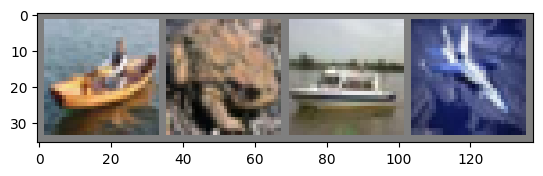

ship frog ship plane


In [9]:
# Function to unnormalize and display an image
def imshow(img):
    img = img / 2 + 0.5  # unnormalize
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.show()

# Get some random training images
dataiter = iter(trainloader)
images, labels = next(dataiter)

# Show images
imshow(torchvision.utils.make_grid(images))
# Print labels
print(' '.join(f'{classes[labels[j]]}' for j in range(4)))

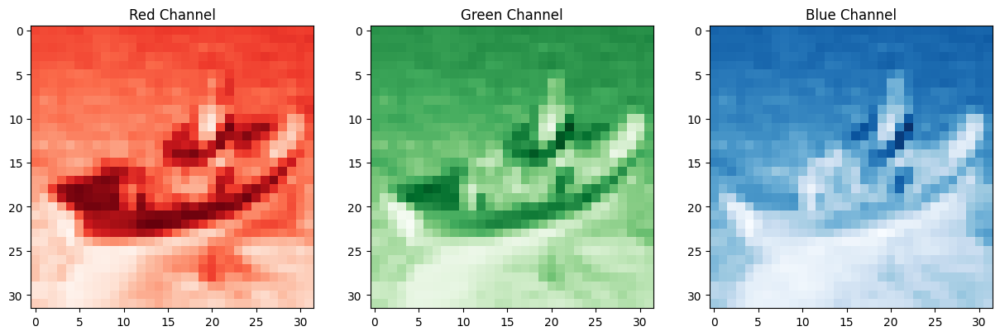

In [10]:
# Visualize the RGB channels of one image
image = images[0].numpy()

# Unnormalize the image
image = image / 2 + 0.5

fig, axs = plt.subplots(1, 3, figsize=(15, 5))

# Red channel
axs[0].imshow(image[0], cmap='Reds')
axs[0].set_title('Red Channel')

# Green channel
axs[1].imshow(image[1], cmap='Greens')
axs[1].set_title('Green Channel')

# Blue channel
axs[2].imshow(image[2], cmap='Blues')
axs[2].set_title('Blue Channel')

plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


torch.Size([4, 3, 32, 32])


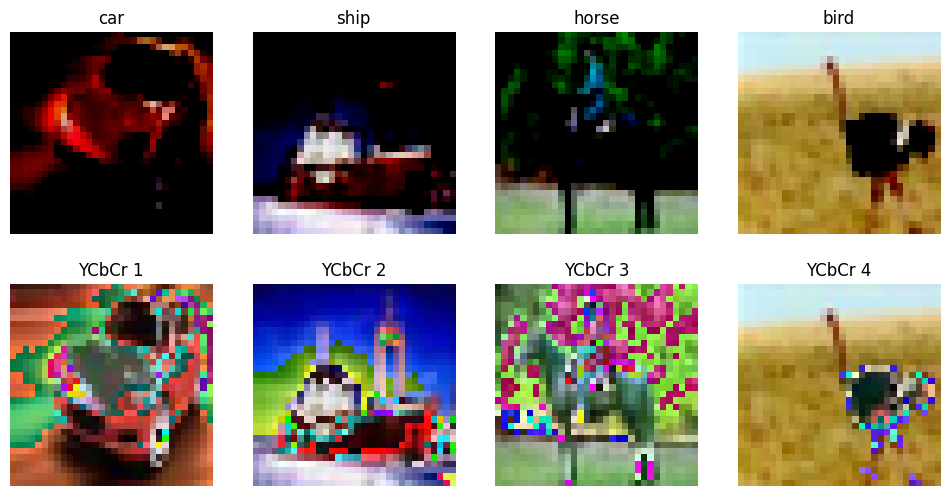

In [11]:
from PIL import Image
def ycbcr(image):
    # Convert the image to YCbCr color space
    image = Image.fromarray(np.uint8(image.numpy().transpose(1, 2, 0) * 255))  # Convert tensor to PIL image
    image_ycbcr = image.convert("YCbCr")
    return image_ycbcr

#getting random images.
dataiter1 = iter(trainloader)
images1, labels1 = next(dataiter1)
print(images1.shape)
ycbcr_images = [ycbcr(image) for image in images1]
fig, axs = plt.subplots(2, 4, figsize=(12, 6))

for i in range(4):
    # Original image
    image = images1[i].numpy().transpose((1, 2, 0))
    axs[0, i].imshow(image)
    axs[0, i].set_title(classes[labels1[i]])
    axs[0, i].axis('off')
    
    # YCbCr image
    axs[1, i].imshow(ycbcr_images[i])
    axs[1, i].set_title(f"YCbCr {i+1}")
    axs[1, i].axis('off')

plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


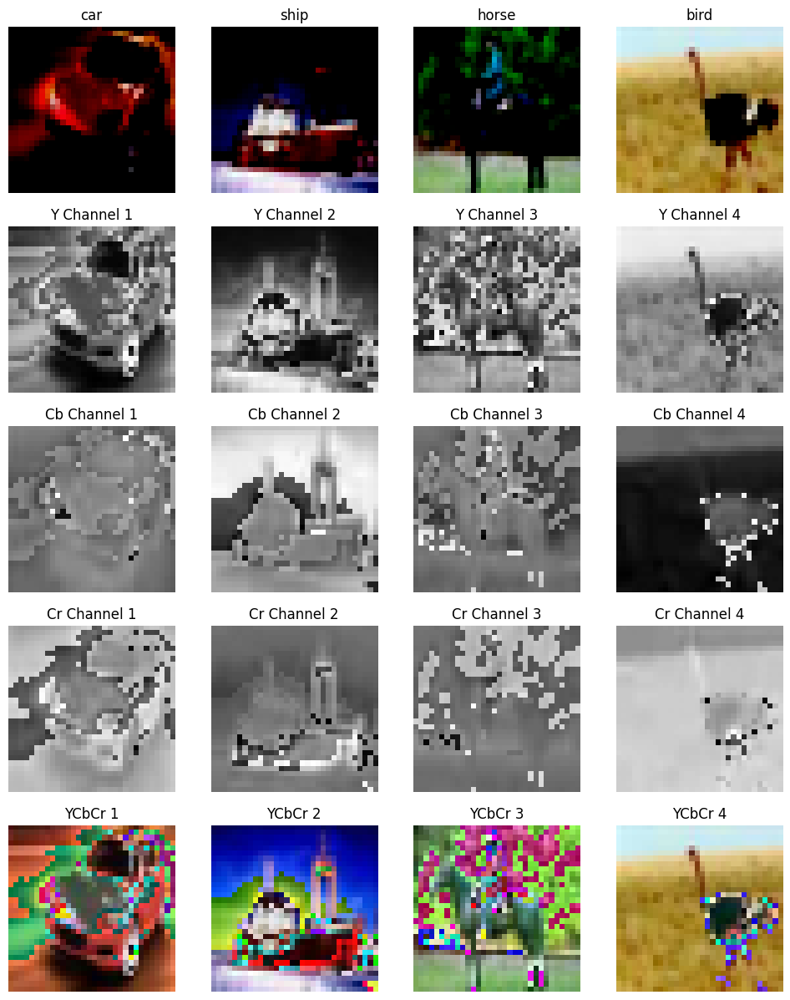

In [12]:
#function for splitting the YCbCr image into its channels.
def split_ycbcr(image_ycbcr):
    y, cb, cr = image_ycbcr.split()
    return y, cb, cr

ycbcr_images = [ycbcr(image) for image in images1]
ycbcr_channels = [split_ycbcr(image) for image in ycbcr_images]

#splitting the YCbCr image into its channels.
fig, axs = plt.subplots(5, 4, figsize=(12, 15))

for i in range(4):
    # Original image
    image = images1[i].numpy().transpose((1, 2, 0))
    axs[0, i].imshow(image)
    axs[0, i].set_title(classes[labels1[i]])
    axs[0, i].axis('off')
    
    # Y channel
    y_channel = np.array(ycbcr_channels[i][0])
    axs[1, i].imshow(y_channel, cmap='gray')
    axs[1, i].set_title(f"Y Channel {i+1}")
    axs[1, i].axis('off')
    
    # Cb channel
    cb_channel = np.array(ycbcr_channels[i][1])
    axs[2, i].imshow(cb_channel, cmap='gray')
    axs[2, i].set_title(f"Cb Channel {i+1}")
    axs[2, i].axis('off')
    
    # Cr channel
    cr_channel = np.array(ycbcr_channels[i][2])
    axs[3, i].imshow(cr_channel, cmap='gray')
    axs[3, i].set_title(f"Cr Channel {i+1}")
    axs[3, i].axis('off')
    
    # YCbCr image
    axs[4, i].imshow(ycbcr_images[i])
    axs[4, i].set_title(f"YCbCr {i+1}")
    axs[4, i].axis('off')

plt.show()

### Methodology is:
1. upscale the images using bicubic interpolation. (making the subimages from the 91 images dataset.)

2. Apply the kernel 

3. Apply ReLU.

4. pass it through the ANNs (reconstruction)

5. pass the class in the training loop.

In [13]:
class CNN(nn.Module):
    def __init__(self):
        super(CNN, self).__init__()
        '''training will only be done on the Y channel as it is giving beter results(et al Image Super-Resolution Using Deep
            Convolutional Networks
            Chao Dong, Chen Change Loy, Member, IEEE, Kaiming He, Member, IEEE,
            and Xiaoou Tang, Fellow, IEEE)'''
        self.conv1 = nn.Conv2d(1, 64, kernel_size=9)
        self.conv2=  nn.Conv2d(64,32,kernel_size=1,padding=6) #we can then try using 9-3-5 architecture.
        self.conv3=  nn.Conv2d(32,1,kernel_size=5)
        
    def forward(self, x):
        #PERFORMIN THE FORWARD PASS.
        x = F.relu(self.conv1(x))
        x = F.relu(self.conv2(x))
        x = F.relu(self.conv3(x))
        return x

In [14]:
critereon=nn.MSELoss()
cnn=CNN()
#what are the other optimizer that would give good results?
#paper used SGD with momentum of 0.9. and lr for first 2 layers was 10^-4 and 10^-5 for the last layer.
optimizer=optim.Adam(cnn.parameters(), lr=0.01)
# back propagations in the paper were 8x10^8.
for epoch in tqdm.tqdm(range(1), desc="Epochs",ascii=True, unit="epoch"):
    running_loss=0.0
    for i,data in enumerate(trainloader):
        inputs, labels=data
        #converting inputs to ycbcr and giving y as input to the model.
        inputs_ycbcr = [Image.fromarray((input.numpy().transpose((1, 2, 0)) * 255).astype(np.uint8)).convert('YCbCr') for input in inputs]
        #upscaling the image to 96x96, which could aslo be used as a ground truth.
        inputs_upscaled = [input.resize((96, 96), Image.BICUBIC) for input in inputs_ycbcr]
        inputs_y = np.array([np.array(inputs)[:, :, 0] for inputs in inputs_upscaled])
        inputs_y = torch.tensor(inputs_y).unsqueeze(1).float() / 255.0  # Normalize to [0, 1]

        optimizer.zero_grad()
        #forward pass
        outputs=cnn(inputs_y)
        #loss
        loss=critereon(outputs, inputs_y)
        loss.backward()
        optimizer.step()
        
        #print statistics
        running_loss+=loss.item()
        if i%6250==6249:
            print(f"[{epoch+1},{i+1}] loss: {running_loss/6250}")
            running_loss=0.0

Epochs:   0%|          | 0/1 [00:00<?, ?epoch/s]

[1,6250] loss: 0.008607973155118525
[1,12500] loss: 0.007987968188785017


Epochs: 100%|##########| 1/1 [11:30<00:00, 690.52s/epoch]


In [15]:
def psnr(img1, img2):
    mse = torch.mean((img1 - img2) ** 2)
    max_pixel = torch.max(img1)
    psnr = 20 * torch.log10(max_pixel / torch.sqrt(mse))
    return psnr
def visualize_psnr(inputs, outputs, labels):
    psnr_values = []
    for i in range(len(inputs)):
        psnr_value = psnr(outputs[i], labels[i])
        psnr_values.append(psnr_value.item())
        
    fig, ax = plt.subplots()
    ax.plot(range(len(inputs)), psnr_values, marker='o')
    ax.set_xlabel('Image Index')
    ax.set_ylabel('PSNR')
    ax.set_title('PSNR Metric')
    plt.show()

C:\Users\Ankit\AppData\Local\Temp\ipykernel_2908\2211655054.py:49: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ..\torch\csrc\utils\tensor_new.cpp:277.)
  labels_y = torch.tensor(labels_y).unsqueeze(1).float() / 255.0  # Normalize to [0, 1]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


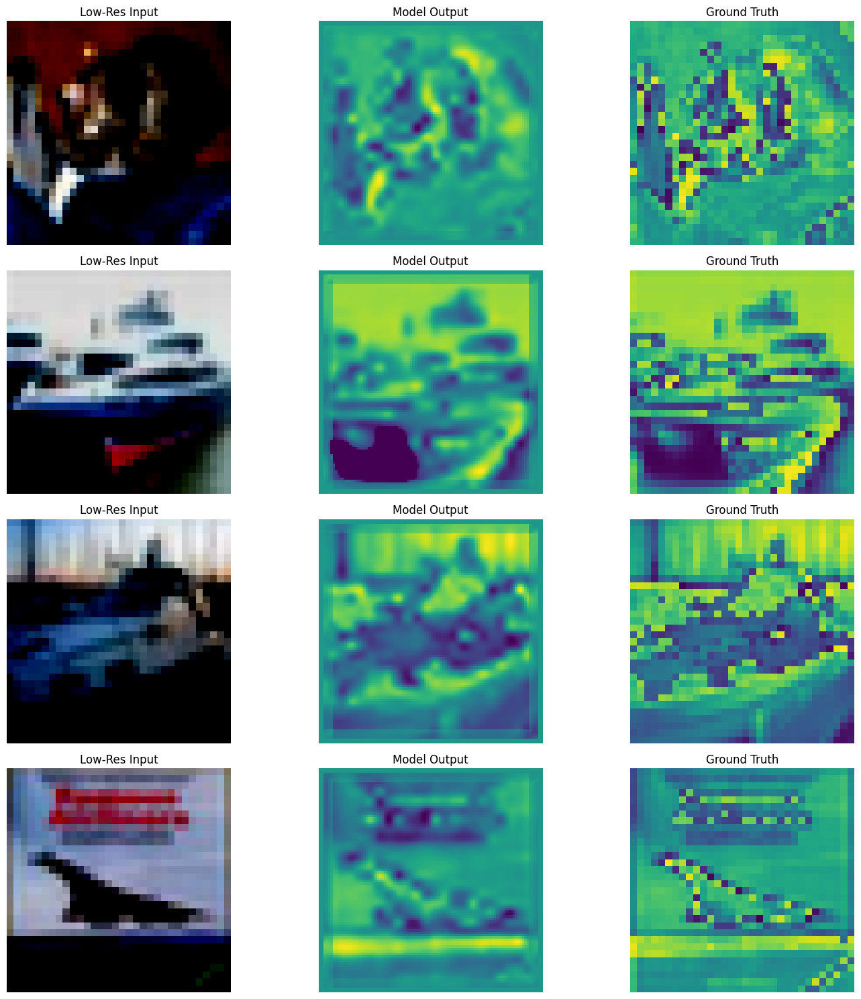

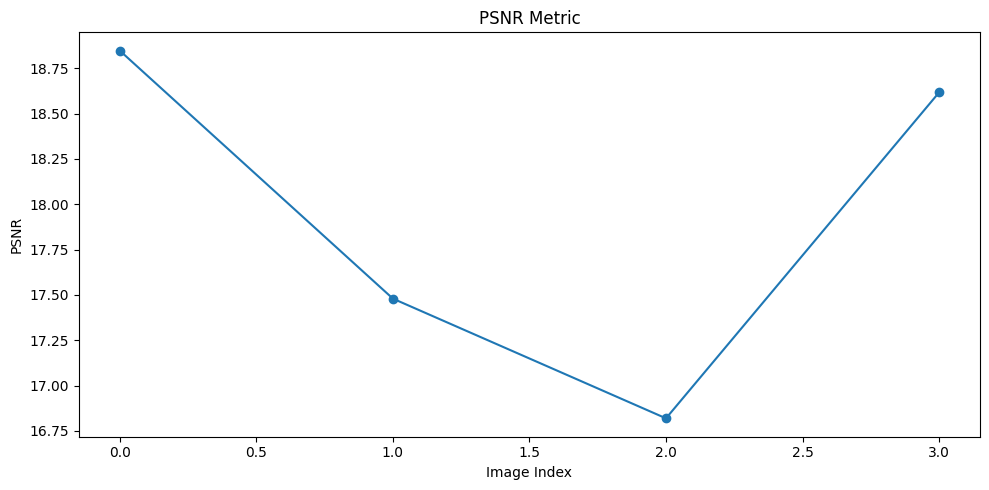

In [16]:
def show_images(inputs, outputs, labels, classes):
    fig, axs = plt.subplots(4, 3, figsize=(15, 15))
    for i in range(4):
        input_img = inputs[i].numpy().transpose((1, 2, 0))
        output_img = outputs[i].detach().numpy().squeeze()
        label_img = labels[i].numpy().squeeze()
       
        axs[i, 0].imshow(input_img)
        axs[i, 0].set_title("Low-Res Input")
        axs[i, 0].axis('off')
        axs[i, 1].imshow(output_img)
        axs[i, 1].set_title("Model Output")
        axs[i, 1].axis('off')
        axs[i, 2].imshow(label_img)
        axs[i, 2].set_title("Ground Truth")
        axs[i, 2].axis('off')
    
    plt.tight_layout()
    plt.show()

def visualize_psnr(outputs, labels):
    psnr_values = []
    for i in range(len(outputs)):
        # Ensure outputs and labels have the same dimensions
        output_resized = F.interpolate(outputs[i].unsqueeze(0), size=labels[i].shape[-2:], mode='bilinear', align_corners=False).squeeze(0)
        psnr_value = psnr(output_resized, labels[i])
        psnr_values.append(psnr_value.item())
    
    fig, ax = plt.subplots(figsize=(10, 5))
    ax.plot(range(len(psnr_values)), psnr_values, marker='o')
    ax.set_xlabel('Image Index')
    ax.set_ylabel('PSNR')
    ax.set_title('PSNR Metric')
    plt.tight_layout()
    plt.show()


# Set the model to evaluation mode
cnn.eval()

# Iterate over the test set
with torch.no_grad():
    for i, data in enumerate(testloader):
        inputs, _ = data
       
        # Convert inputs to YCbCr and extract the Y channel for high-resolution ground truth
        inputs_ycbcr = [Image.fromarray((input.numpy().transpose((1, 2, 0)) * 255).astype(np.uint8)).convert('YCbCr') for input in inputs]
        labels_y = [np.array(input)[:, :, 0] for input in inputs_ycbcr]
        labels_y = torch.tensor(labels_y).unsqueeze(1).float() / 255.0  # Normalize to [0, 1]
       
        # Downscale high-resolution images to create low-resolution inputs
        inputs_low_res = [input.resize((24, 24), Image.BICUBIC) for input in inputs_ycbcr]
        # Upscale low-resolution images back to high-resolution size
        inputs_upscaled = [input.resize((96, 96), Image.BICUBIC) for input in inputs_low_res]
        inputs_y = [np.array(input)[:, :, 0] for input in inputs_upscaled]
        inputs_y = torch.tensor(inputs_y).unsqueeze(1).float() / 255.0  # Normalize to [0, 1]
       
        # Forward pass
        outputs = cnn(inputs_y)
       
        # Visualize the results for the first batch
        if i == 0:
            show_images(inputs, outputs, labels_y, testset.classes)
            visualize_psnr(outputs, labels_y)
            break

In [17]:
class CNN_color(nn.Module):
    def __init__(self):
        super(CNN_color, self).__init__()
        '''training will only be done on the Y channel as it is giving beter results(et al Image Super-Resolution Using Deep
            Convolutional Networks
            Chao Dong, Chen Change Loy, Member, IEEE, Kaiming He, Member, IEEE,
            and Xiaoou Tang, Fellow, IEEE)'''
        self.conv1 = nn.Conv2d(3, 64, kernel_size=9)
        self.conv2=  nn.Conv2d(64,32,kernel_size=1,padding=6) #we can then try using 9-3-5 architecture.
        self.conv3=  nn.Conv2d(32,3,kernel_size=5)
        
    def forward(self, x):
        #PERFORMIN THE FORWARD PASS.
        x = F.relu(self.conv1(x))
        x = F.relu(self.conv2(x))
        x = F.relu(self.conv3(x))
        return x

In [18]:
critereon=nn.MSELoss()
cnn_color=CNN_color()
#what are the other optimizer that would give good results?
#paper used SGD with momentum of 0.9. and lr for first 2 layers was 10^-4 and 10^-5 for the last layer.
optimizer=optim.Adam(cnn.parameters(), lr=0.01)
# back propagations in the paper were 8x10^8.
for epoch in tqdm.tqdm(range(1), desc="Epochs", ascii=True, unit="epoch"):
    running_loss = 0.0
    for i, data in enumerate(trainloader):
        inputs, _ = data
        
        # Upscale images to target size (example using bicubic interpolation)
        inputs_upscaled = F.interpolate(inputs, size=(96, 96), mode='bicubic')
        
        optimizer.zero_grad()
        
        # Forward pass
        outputs = cnn_color(inputs_upscaled)
        
        # Calculate loss
        loss = critereon(outputs, inputs_upscaled)
        loss.backward()
        optimizer.step()
        
        # Print statistics
        running_loss += loss.item()
        if i % 6250 == 6249:  # Print every 6250 batches
            print(f"[{epoch+1}, {i+1}] loss: {running_loss / 6250}")
            running_loss = 0.0

print("Finished Training")

Epochs:   0%|          | 0/1 [00:00<?, ?epoch/s]

[1, 6250] loss: 0.262527566986084
[1, 12500] loss: 0.2607248448371887


Epochs: 100%|##########| 1/1 [09:51<00:00, 591.32s/epoch]

Finished Training


the colored channels are a lost cause.

## donig the same thing but on subimages from the 91 images dataset. (imagenet can also be used.)

In [19]:
def add_images_from_directory(directory):
    images = []
    for filename in os.listdir(directory):
        if filename.lower().endswith(('.jpg', '.png')):  # Add more extensions if needed
            image_path = os.path.join(directory, filename)
            try:
                with Image.open(image_path) as img:
                    images.append(img.copy())  # We use copy() to keep the image in memory after closing the file
            except IOError:
                print(f"Error loading image: {image_path}")
    return images

In [20]:
lr=[]
lr_directory = r'C:\Users\Ankit\Documents\Vedanshi\T_91\T91_LR'
hr_directory = r'C:\Users\Ankit\Documents\Vedanshi\T_91\T91_HR'
lr=add_images_from_directory(lr_directory)
hr=add_images_from_directory(hr_directory)
lr_ycbcr=[image.convert('YCbCr') for image in lr]
hr_ycbcr=[image.convert('YCbCr') for image in hr]
lr_y=[np.array(image)[:,:,0] for image in lr_ycbcr]
hr_y=[np.array(image)[:,:,0] for image in hr_ycbcr]

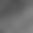

In [21]:
img=lr_y[0]
img=Image.fromarray(img)
img

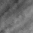

In [22]:
img_hr=hr_y[0]
img_hr=Image.fromarray(img_hr)
img_hr

In [23]:
#a class for creating the train and test dataset.
class SRDataset(Dataset):
    def __init__(self, lr_images, hr_images, transform=None):
        self.lr_images = lr_images
        self.hr_images = hr_images
        self.transform = transform

    def __len__(self):
        return len(self.lr_images)

    def __getitem__(self, idx):
        lr_image = self.lr_images[idx]
        hr_image = self.hr_images[idx]
        
        # Convert PIL Images to tensors
        to_tensor = transforms.ToTensor()
        lr_tensor = to_tensor(lr_image)
        hr_tensor = to_tensor(hr_image)
        
        if self.transform:
            lr_tensor = self.transform(lr_tensor)
            hr_tensor = self.transform(hr_tensor)
        
        return lr_tensor, hr_tensor

In [24]:
#making train and test loaders for the y channels of the images.
train_split = 0.8  # 80% for training, 20% for testing
split_idx = int(len(lr_y) * train_split)

train_lr = lr_y[:split_idx]
train_hr = hr_y[:split_idx]
test_lr = lr_y[split_idx:]
test_hr = hr_y[split_idx:]

# Create datasets
train_dataset = SRDataset(train_lr, train_hr)
test_dataset = SRDataset(test_lr, test_hr)

# Create dataloaders
batch_size = 1000
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

In [25]:
def calculate_psnr(img1, img2):
    mse = F.mse_loss(img1, img2)
    if mse == 0:
        return float('inf')
    psnr = 20 * torch.log10(1.0 / torch.sqrt(mse))
    return psnr

Epochs: 100%|##########| 100/100 [34:49<00:00, 20.90s/epoch]


ValueError: x and y must have same first dimension, but have shapes (100,) and (0,)

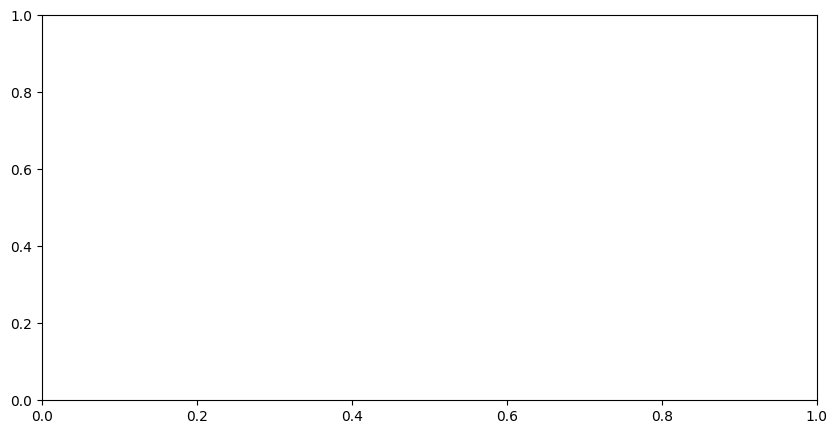

In [26]:
cnn_91 = CNN()
criterion = nn.MSELoss()
optimizer = optim.Adam(cnn_91.parameters(), lr=0.01)
num_epochs = 100

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
cnn_91 = cnn_91.to(device)
psnr_values = []
for epoch in tqdm.tqdm(range(num_epochs), desc="Epochs", ascii=True, unit="epoch"):
    running_loss = 0.0
    running_psnr = 0.0
    batch_count = 0
    cnn_91.train()  # Set the model to training mode
    for i, (low_res, high_res) in enumerate(train_loader):
        # Move inputs and labels to the same device as the model
        low_res = low_res.to(device)
        high_res = high_res.to(device)
        
        # Zero the parameter gradients
        optimizer.zero_grad()
        
        # Forward pass
        outputs = cnn_91(low_res)
        
        # Compute loss
        loss = criterion(outputs, high_res)
        
        # Compute PSNR
        psnr = calculate_psnr(outputs, high_res)
        
        # Backward pass and optimize
        loss.backward()
        optimizer.step()
        
        # Accumulate statistics
        running_loss += loss.item()
        running_psnr += psnr.item()
        batch_count += 1
        
        if i % 100 == 99:  # print every 100 mini-batches
            avg_loss = running_loss / batch_count
            avg_psnr = running_psnr / batch_count
            print(f'[Epoch {epoch + 1}, Batch {i + 1}] loss: {avg_loss:.3f}, PSNR: {avg_psnr:.2f} dB')
            running_loss = 0.0
            running_psnr = 0.0
            batch_count = 0

    # Store PSNR value for each epoch
    avg_psnr = running_psnr / batch_count if batch_count > 0 else 0
    psnr_values.append(avg_psnr)

# Plot the PSNR values after training
plt.figure(figsize=(10, 5))
plt.plot(range(1, num_epochs + 1), psnr_values, label='PSNR')
plt.xlabel('Epoch')
plt.ylabel('PSNR (dB)')
plt.title('PSNR During Training')
plt.legend()
plt.show()